# OF-driven Gaussian denoising

In [1]:
!which python

/shared/PEs/farneback-python/bin/python


In [2]:
#!pip install --upgrade pip

In [3]:
import numpy as np
import scipy.ndimage
import matplotlib.pyplot as plt
from ipywidgets import *
import cv2
import time
#import kernels
#import _2D_OF_denoising2 as _2D_OF_denoising
import logging

In [4]:
!pip uninstall -y "image_denoising @ git+https://github.com/microscopy-processing/image_denoising"

In [5]:
# Run this cell when image_denoising is installed as a package

#!pip install "image_denoising @ git+https://github.com/microscopy-processing/image_denoising"
#!pip show image_denoising
#import image_denoising

In [6]:
try:
    from image_IO import image_1 as gray_image
    from image_IO import image_3 as RGB_image
except:
    !pip install "image_IO @ git+https://github.com/vicente-gonzalez-ruiz/image_IO"
    from image_IO import image_1 as gray_image
    from image_IO import image_3 as RGB_image

In [7]:
!rm lena.png.?
!wget http://www.hpca.ual.es/~vruiz/images/lena.png

--2023-08-02 12:55:10--  http://www.hpca.ual.es/~vruiz/images/lena.png
Resolving www.hpca.ual.es (www.hpca.ual.es)... 150.214.150.42
Connecting to www.hpca.ual.es (www.hpca.ual.es)|150.214.150.42|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 512673 (501K) [image/png]
Saving to: ‘lena.png.1’

lena.png.1          100%[===================>] 500,66K  1,10MB/s    in 0,4s    

2023-08-02 12:55:11 (1,10 MB/s) - ‘lena.png.1’ saved [512673/512673]



In [8]:
img = RGB_image.read("lena.png")

[image_3.py:39 read() INFO] lena.png (512, 512, 3) uint8 len=512673 max=255 min=1


[image_3.py:87 print_stats() INFO] component=0 max=255 min=54 avg=180.22401428222656
[image_3.py:87 print_stats() INFO] component=1 max=248 min=1 avg=99.05646133422852
[image_3.py:87 print_stats() INFO] component=2 max=239 min=8 avg=105.41263198852539


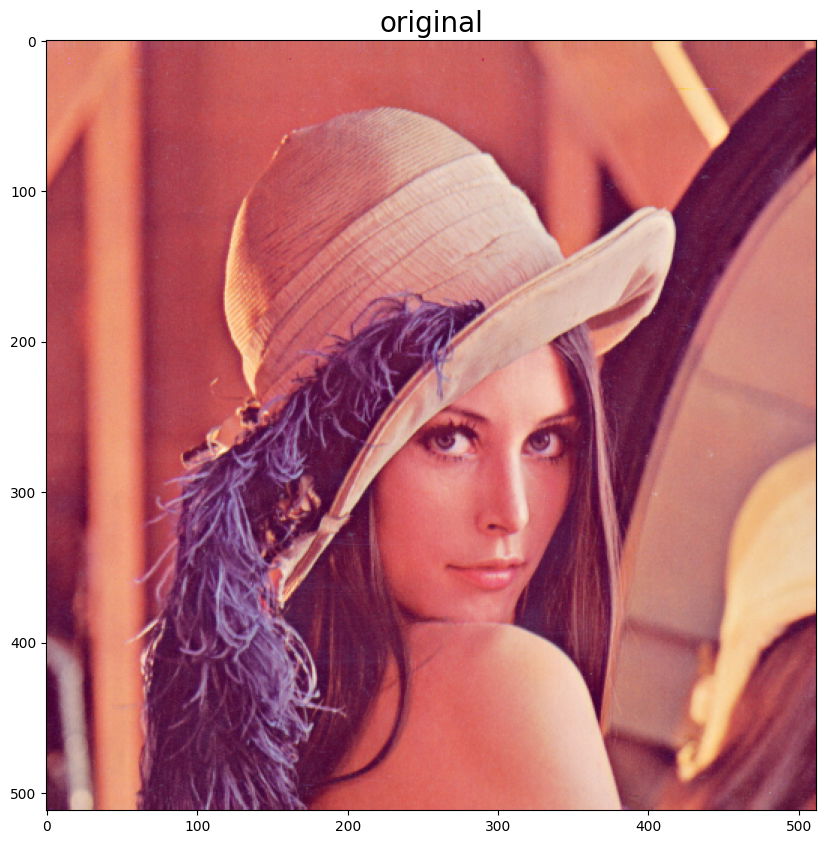

In [9]:
RGB_image.show(img, "original")

In [10]:
mean = 0
var = 200
sigma = var**0.5
noise = np.random.normal(mean,sigma,img.shape).reshape(img.shape)
noisy_img = np.clip((img + noise), 0, 255).astype(np.uint8)

[image_3.py:87 print_stats() INFO] component=0 max=255 min=20 avg=179.6025848388672
[image_3.py:87 print_stats() INFO] component=1 max=255 min=0 avg=98.67915725708008
[image_3.py:87 print_stats() INFO] component=2 max=255 min=0 avg=104.93950271606445


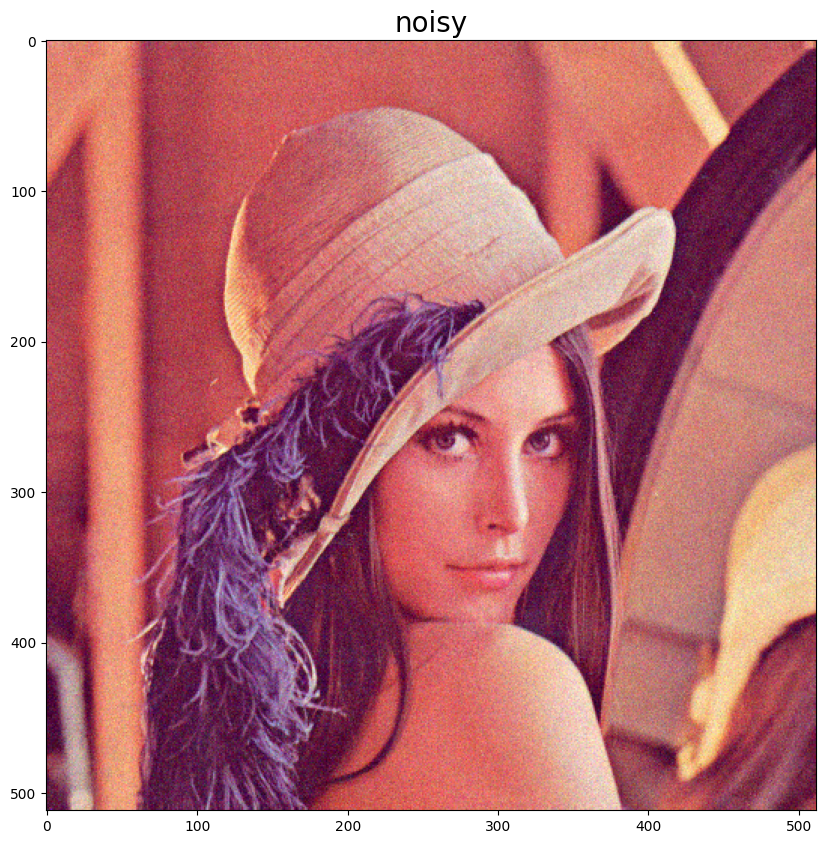

In [11]:
RGB_image.show(noisy_img, "noisy")

## Gaussian

In [12]:
import image_denoising
from image_denoising import gaussian
image_denoising.gaussian.logger.setLevel(logging.WARNING)
logging.getLevelName(image_denoising.gaussian.logger.getEffectiveLevel())

'WARNING'

In [13]:
%%time

GD__N_iters = 1
GD__sigma = 2.5

denoised, _ = image_denoising.gaussian.filter_RGB_image(noisy_img, GD__sigma, GD__N_iters)


CPU times: user 151 ms, sys: 0 ns, total: 151 ms
Wall time: 151 ms


[image_3.py:87 print_stats() INFO] component=0 max=248 min=77 avg=179.11209869384766
[image_3.py:87 print_stats() INFO] component=1 max=219 min=12 avg=98.21821975708008
[image_3.py:87 print_stats() INFO] component=2 max=204 min=51 avg=104.49367141723633


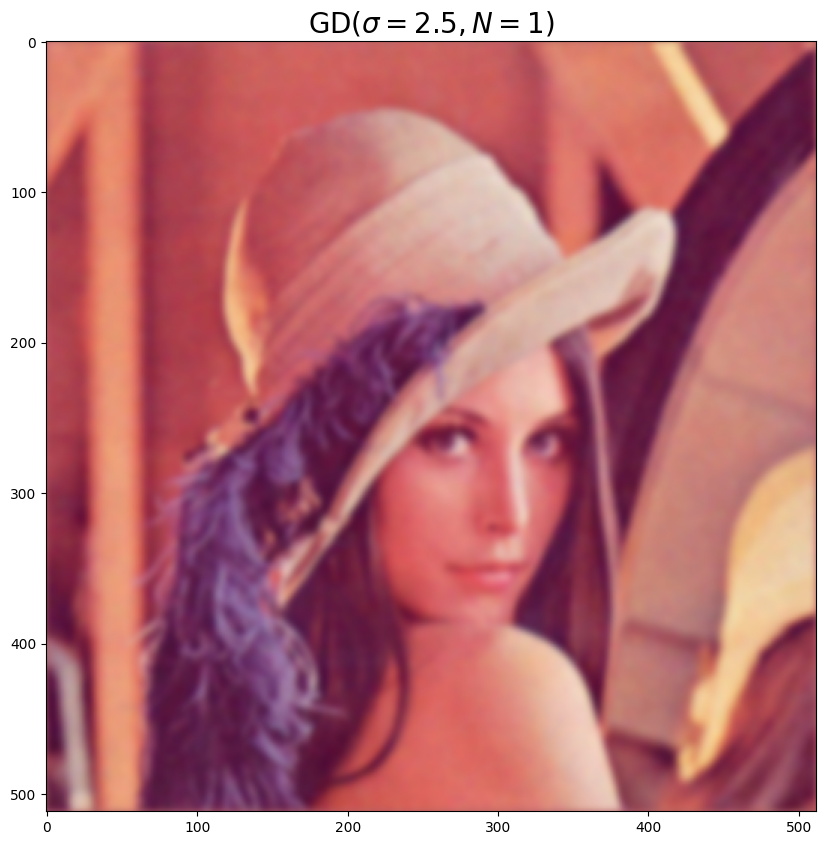

In [14]:
RGB_image.show(denoised.astype(np.uint8), "GD" + "($\sigma=" + f"{GD__sigma}, N={GD__N_iters}$)")

## OF-driven Gaussian

In [15]:
import image_denoising
from image_denoising import OF_gaussian
image_denoising.OF_gaussian.logger.setLevel(logging.WARNING)
logging.getLevelName(image_denoising.OF_gaussian.logger.getEffectiveLevel())

'WARNING'

In [16]:
%%time

OFGD__sigma_kernel = 2.5
OFGD__N_iters = 1
OFGD__l = 1
OFGD__w = 9
OFGD__sigma_OF = 2.5

denoised, _ = image_denoising.OF_gaussian.filter_RGB_image(noisy_img, OFGD__sigma_kernel, OFGD__N_iters, OFGD__l, OFGD__w, OFGD__sigma_OF)

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 27

[image_3.py:87 print_stats() INFO] component=0 max=248 min=82 avg=179.1244888305664
[image_3.py:87 print_stats() INFO] component=1 max=212 min=13 avg=98.25958251953125
[image_3.py:87 print_stats() INFO] component=2 max=198 min=52 avg=104.54970169067383


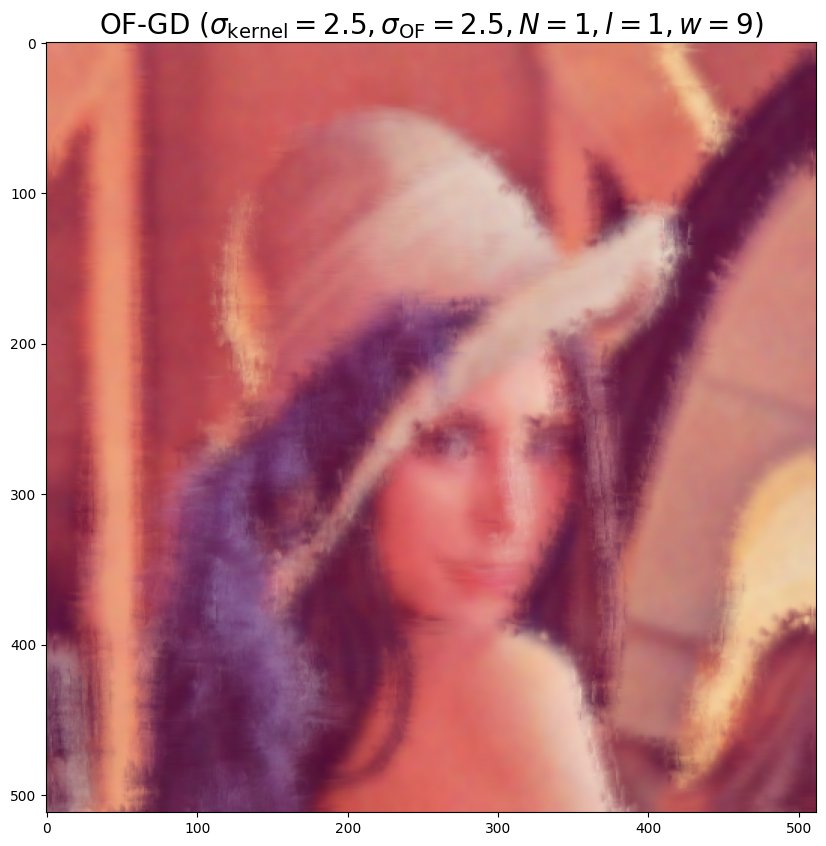

In [17]:
RGB_image.show(denoised.astype(np.uint8), "OF-GD " + "($\sigma_\mathrm{kernel}=" + f"{OFGD__sigma_kernel}"  + ", \sigma_\mathrm{OF}=" + f"{OFGD__sigma_OF}" + f", N={OFGD__N_iters}, l={OFGD__l}, w={OFGD__w}$)")

In [18]:
%%time

OFGD__sigma_kernel = 2.5
OFGD__N_iters = 3
OFGD__l = 1
OFGD__w = 9
OFGD__sigma_OF = 2.5

denoised, _ = image_denoising.OF_gaussian.filter_RGB_image(noisy_img, OFGD__sigma_kernel, OFGD__N_iters, OFGD__l, OFGD__w, OFGD__sigma_OF)

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 27

141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 277 278 279 280 281 282 283 284 285 286 287 288 289 290 291 292 293 294 295 296 297 298 299 300 301 302 303 304 305 306 307 308 309 310 311 312 313 314 315 316 317 318 319 320 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 

[image_3.py:87 print_stats() INFO] component=0 max=242 min=86 avg=179.20603942871094
[image_3.py:87 print_stats() INFO] component=1 max=209 min=17 avg=98.32574844360352
[image_3.py:87 print_stats() INFO] component=2 max=191 min=56 avg=104.58264923095703


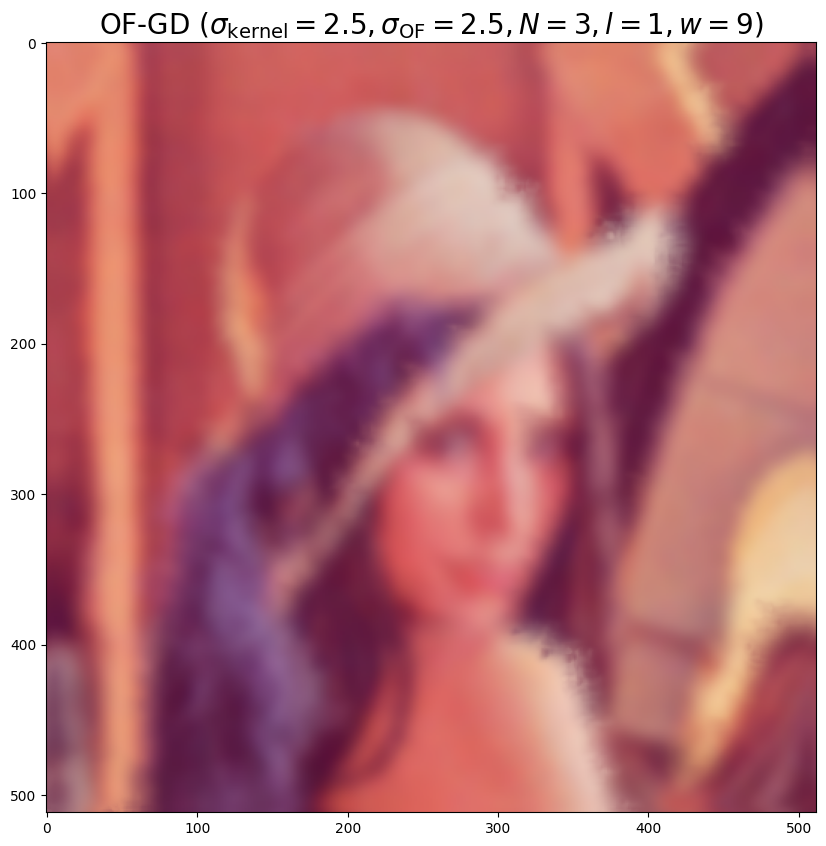

In [19]:
RGB_image.show(denoised.astype(np.uint8), "OF-GD " + "($\sigma_\mathrm{kernel}=" + f"{OFGD__sigma_kernel}"  + ", \sigma_\mathrm{OF}=" + f"{OFGD__sigma_OF}" + f", N={OFGD__N_iters}, l={OFGD__l}, w={OFGD__w}$)")

In [20]:
%%time

OFGD__sigma_kernel = 2.5
OFGD__N_iters = 1
OFGD__l = 3
OFGD__w = 9
OFGD__sigma_OF = 2.5

denoised, _ = image_denoising.OF_gaussian.filter_RGB_image(noisy_img, OFGD__sigma_kernel, OFGD__N_iters, OFGD__l, OFGD__w, OFGD__sigma_OF)

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 27

[image_3.py:87 print_stats() INFO] component=0 max=248 min=82 avg=179.1244888305664
[image_3.py:87 print_stats() INFO] component=1 max=212 min=13 avg=98.25958251953125
[image_3.py:87 print_stats() INFO] component=2 max=198 min=52 avg=104.54970169067383


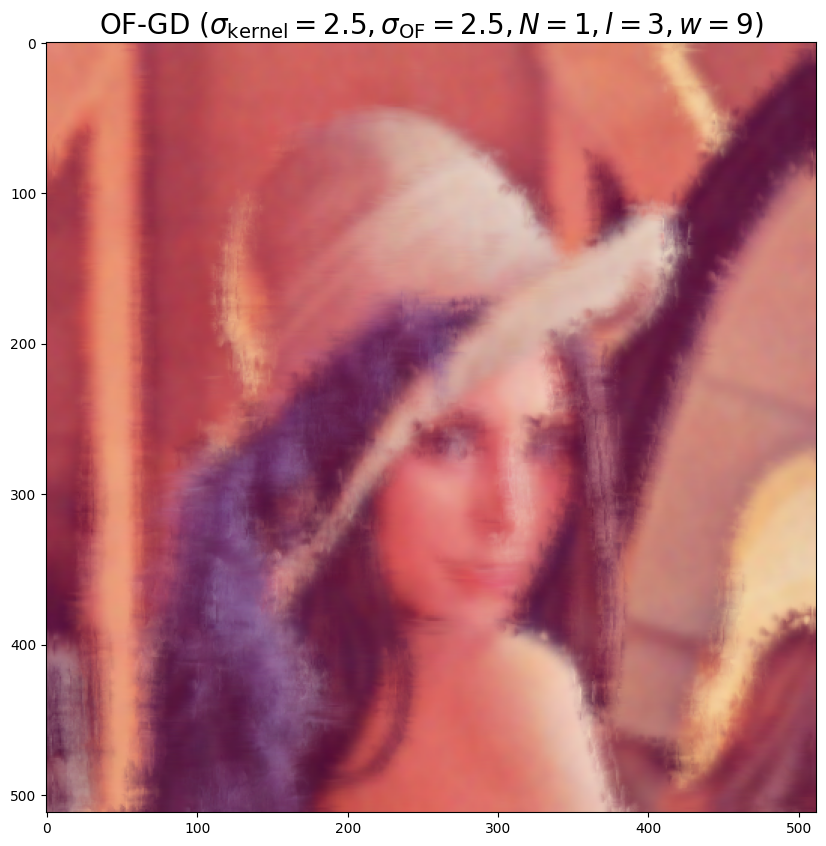

In [21]:
RGB_image.show(denoised.astype(np.uint8), "OF-GD " + "($\sigma_\mathrm{kernel}=" + f"{OFGD__sigma_kernel}"  + ", \sigma_\mathrm{OF}=" + f"{OFGD__sigma_OF}" + f", N={OFGD__N_iters}, l={OFGD__l}, w={OFGD__w}$)")

In [22]:
%%time

OFGD__sigma_kernel = 2.5
OFGD__N_iters = 1
OFGD__l = 3
OFGD__w = 33
OFGD__sigma_OF = 2.5

denoised, _ = image_denoising.OF_gaussian.filter_RGB_image(noisy_img, OFGD__sigma_kernel, OFGD__N_iters, OFGD__l, OFGD__w, OFGD__sigma_OF)

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 27

[image_3.py:87 print_stats() INFO] component=0 max=245 min=82 avg=179.1833152770996
[image_3.py:87 print_stats() INFO] component=1 max=213 min=13 avg=98.2785415649414
[image_3.py:87 print_stats() INFO] component=2 max=197 min=53 avg=104.48251724243164


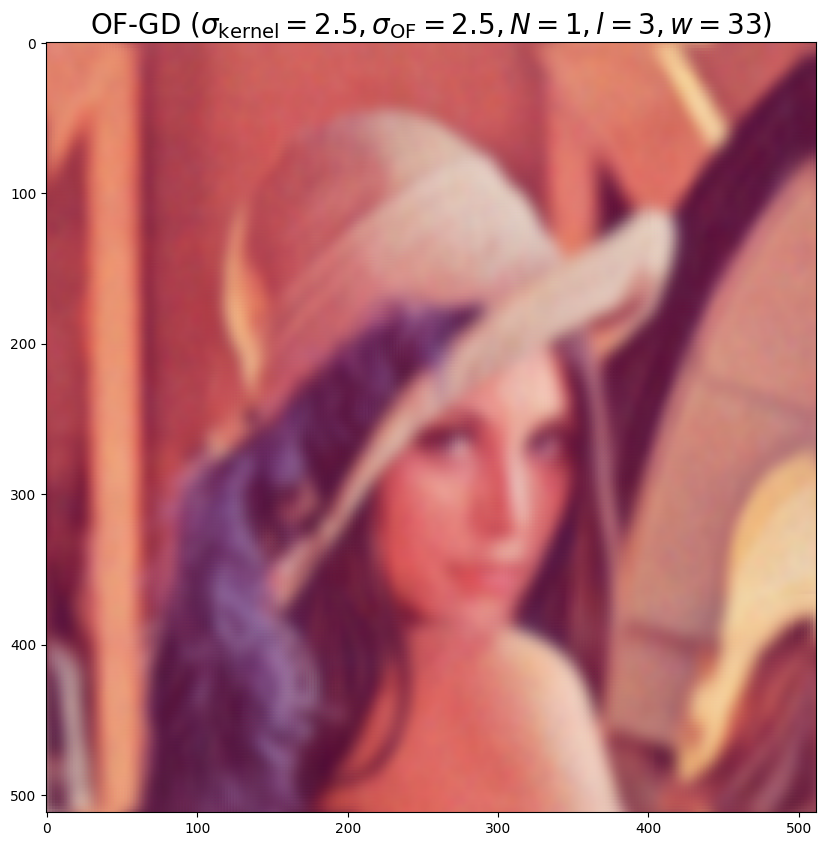

In [23]:
RGB_image.show(denoised.astype(np.uint8), "OF-GD " + "($\sigma_\mathrm{kernel}=" + f"{OFGD__sigma_kernel}"  + ", \sigma_\mathrm{OF}=" + f"{OFGD__sigma_OF}" + f", N={OFGD__N_iters}, l={OFGD__l}, w={OFGD__w}$)")

In [24]:
%%time

OFGD__sigma_kernel = 2.5
OFGD__N_iters = 1
OFGD__l = 3
OFGD__w = 33
OFGD__sigma_OF = 0.5

denoised, _ = image_denoising.OF_gaussian.filter_RGB_image(noisy_img, OFGD__sigma_kernel, OFGD__N_iters, OFGD__l, OFGD__w, OFGD__sigma_OF)

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 27

[image_3.py:87 print_stats() INFO] component=0 max=246 min=81 avg=179.1472396850586
[image_3.py:87 print_stats() INFO] component=1 max=213 min=14 avg=98.2447395324707
[image_3.py:87 print_stats() INFO] component=2 max=198 min=52 avg=104.4732780456543


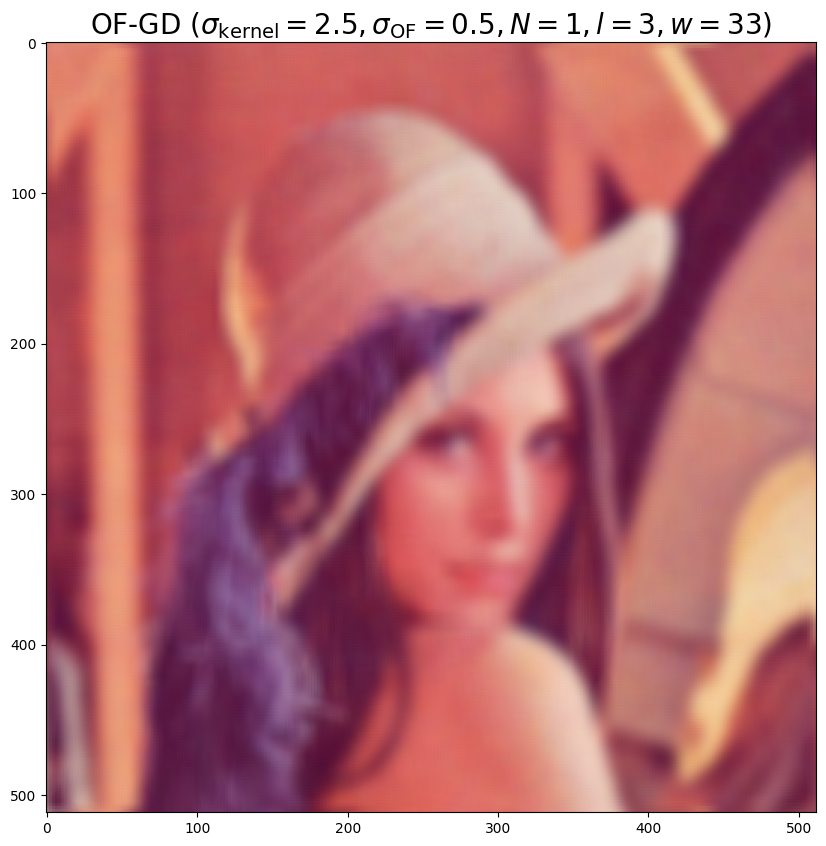

In [25]:
RGB_image.show(denoised.astype(np.uint8), "OF-GD " + "($\sigma_\mathrm{kernel}=" + f"{OFGD__sigma_kernel}"  + ", \sigma_\mathrm{OF}=" + f"{OFGD__sigma_OF}" + f", N={OFGD__N_iters}, l={OFGD__l}, w={OFGD__w}$)")

In [26]:
%%time

OFGD__sigma_kernel = 2.5
OFGD__N_iters = 1
OFGD__l = 3
OFGD__w = 33
OFGD__sigma_OF = 0.25

denoised, _ = image_denoising.OF_gaussian.filter_RGB_image(noisy_img, OFGD__sigma_kernel, OFGD__N_iters, OFGD__l, OFGD__w, OFGD__sigma_OF)

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 27

[image_3.py:87 print_stats() INFO] component=0 max=246 min=81 avg=179.14791107177734
[image_3.py:87 print_stats() INFO] component=1 max=213 min=13 avg=98.24398803710938
[image_3.py:87 print_stats() INFO] component=2 max=198 min=52 avg=104.47312927246094


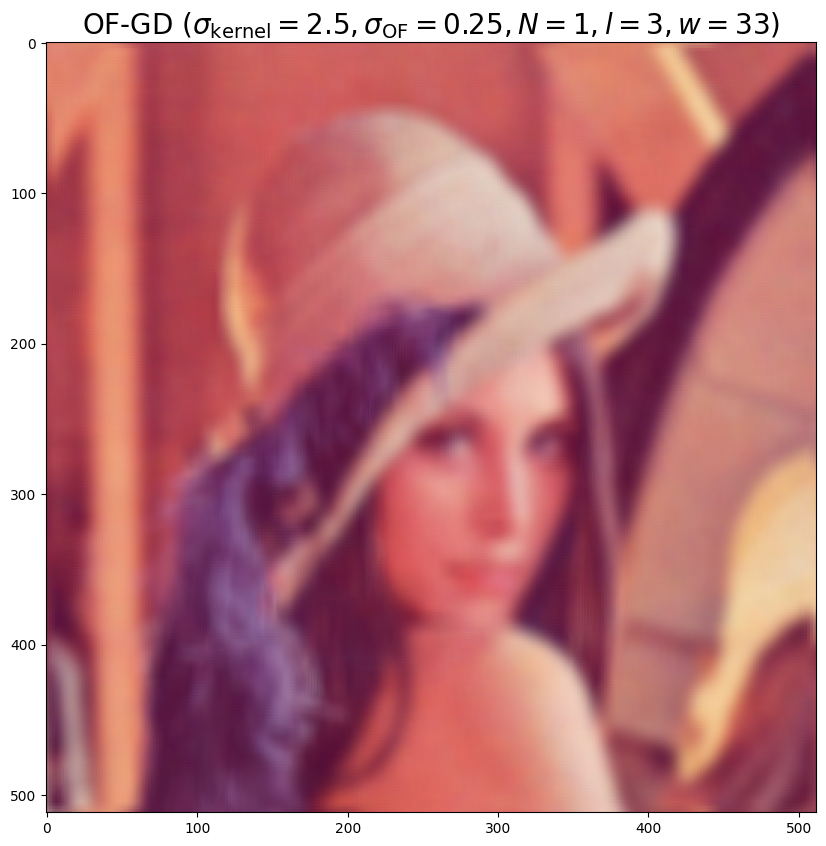

In [27]:
RGB_image.show(denoised.astype(np.uint8), "OF-GD " + "($\sigma_\mathrm{kernel}=" + f"{OFGD__sigma_kernel}"  + ", \sigma_\mathrm{OF}=" + f"{OFGD__sigma_OF}" + f", N={OFGD__N_iters}, l={OFGD__l}, w={OFGD__w}$)")

In [28]:
%%time

OFGD__sigma_kernel = 2.5
OFGD__N_iters = 1
OFGD__l = 3
OFGD__w = 17
OFGD__sigma_OF = 0.25

denoised, _ = image_denoising.OF_gaussian.filter_RGB_image(noisy_img, OFGD__sigma_kernel, OFGD__N_iters, OFGD__l, OFGD__w, OFGD__sigma_OF)

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 27

[image_3.py:87 print_stats() INFO] component=0 max=246 min=80 avg=179.2242317199707
[image_3.py:87 print_stats() INFO] component=1 max=213 min=13 avg=98.33636856079102
[image_3.py:87 print_stats() INFO] component=2 max=198 min=52 avg=104.57105255126953


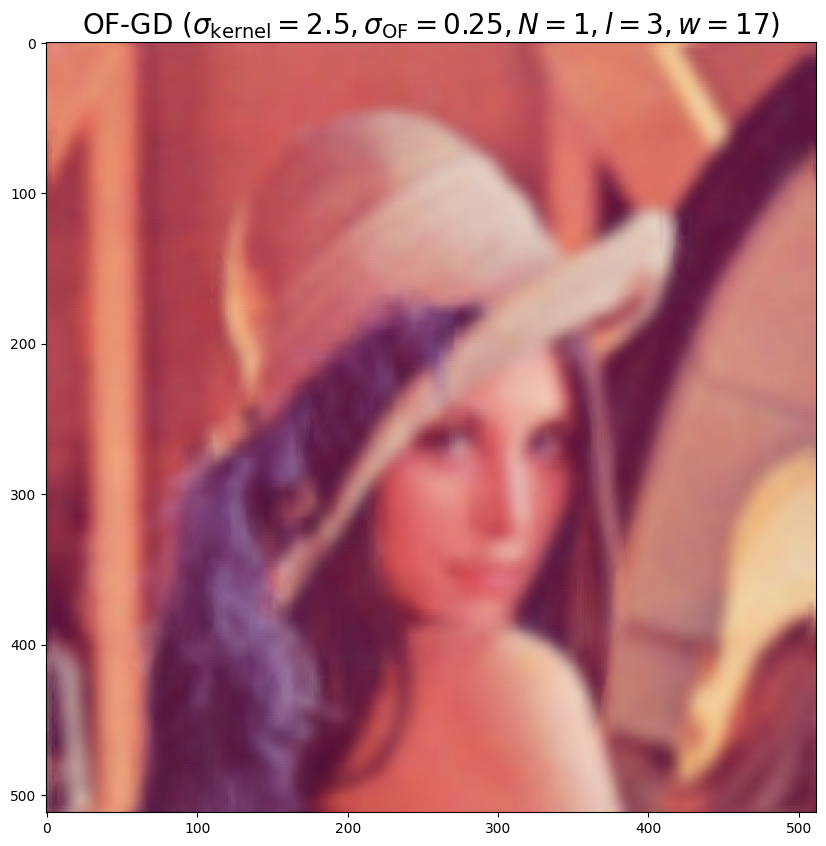

In [29]:
RGB_image.show(denoised.astype(np.uint8), "OF-GD " + "($\sigma_\mathrm{kernel}=" + f"{OFGD__sigma_kernel}"  + ", \sigma_\mathrm{OF}=" + f"{OFGD__sigma_OF}" + f", N={OFGD__N_iters}, l={OFGD__l}, w={OFGD__w}$)")

In [30]:
%%time

OFGD__sigma_kernel = 0.5
OFGD__N_iters = 1
OFGD__l = 3
OFGD__w = 17
OFGD__sigma_OF = 0.25

denoised, _ = image_denoising.OF_gaussian.filter_gray_image(noisy_img, OFGD__sigma_kernel, OFGD__N_iters, OFGD__l, OFGD__w, OFGD__sigma_OF)

v3
0 

error: OpenCV(4.7.0) /io/opencv/modules/video/src/optflowgf.cpp:1115: error: (-215:Assertion failed) prev0.size() == next0.size() && prev0.channels() == next0.channels() && prev0.channels() == 1 && pyrScale_ < 1 in function 'calc'


[image_3.py:87 print_stats() INFO] component=0 max=246 min=80 avg=179.2242317199707
[image_3.py:87 print_stats() INFO] component=1 max=213 min=13 avg=98.33636856079102
[image_3.py:87 print_stats() INFO] component=2 max=198 min=52 avg=104.57105255126953


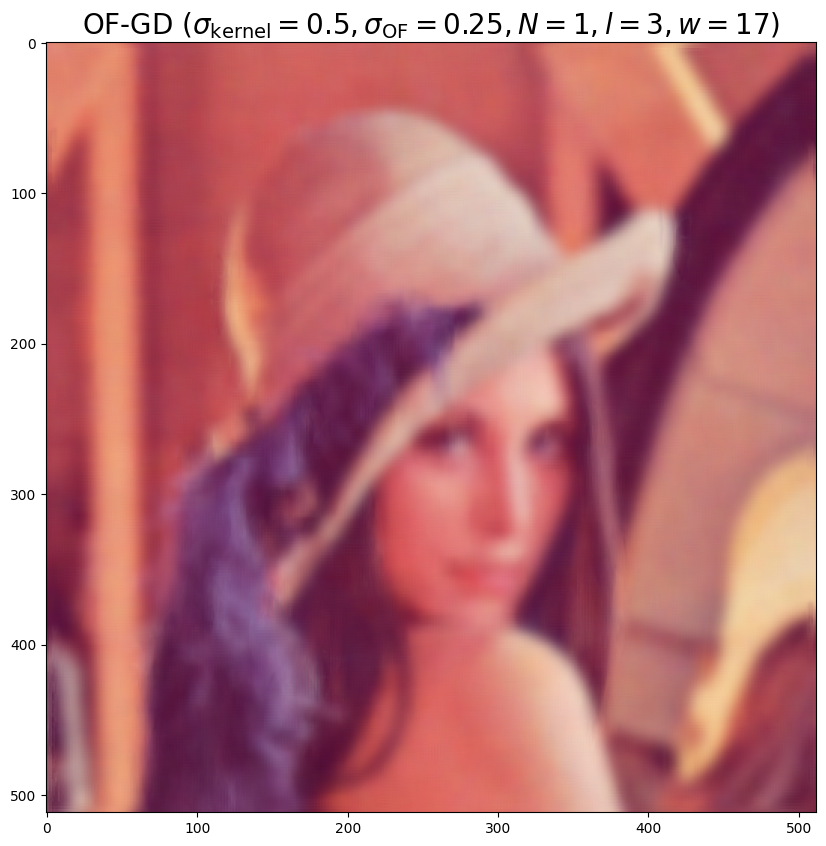

In [31]:
RGB_image.show(denoised.astype(np.uint8), "OF-GD " + "($\sigma_\mathrm{kernel}=" + f"{OFGD__sigma_kernel}"  + ", \sigma_\mathrm{OF}=" + f"{OFGD__sigma_OF}" + f", N={OFGD__N_iters}, l={OFGD__l}, w={OFGD__w}$)")

In [32]:
%%time

OFGD__sigma_kernel = 0.5
OFGD__N_iters = 1
OFGD__l = 3
OFGD__w = 17
OFGD__sigma_OF = 2.5

denoised, _ = image_denoising.OF_gaussian.filter_RGB_image(noisy_img, OFGD__sigma_kernel, OFGD__N_iters, OFGD__l, OFGD__w, OFGD__sigma_OF)

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 27

[image_3.py:87 print_stats() INFO] component=0 max=254 min=45 avg=179.10426330566406
[image_3.py:87 print_stats() INFO] component=1 max=245 min=0 avg=98.1828384399414
[image_3.py:87 print_stats() INFO] component=2 max=235 min=23 avg=104.44247817993164


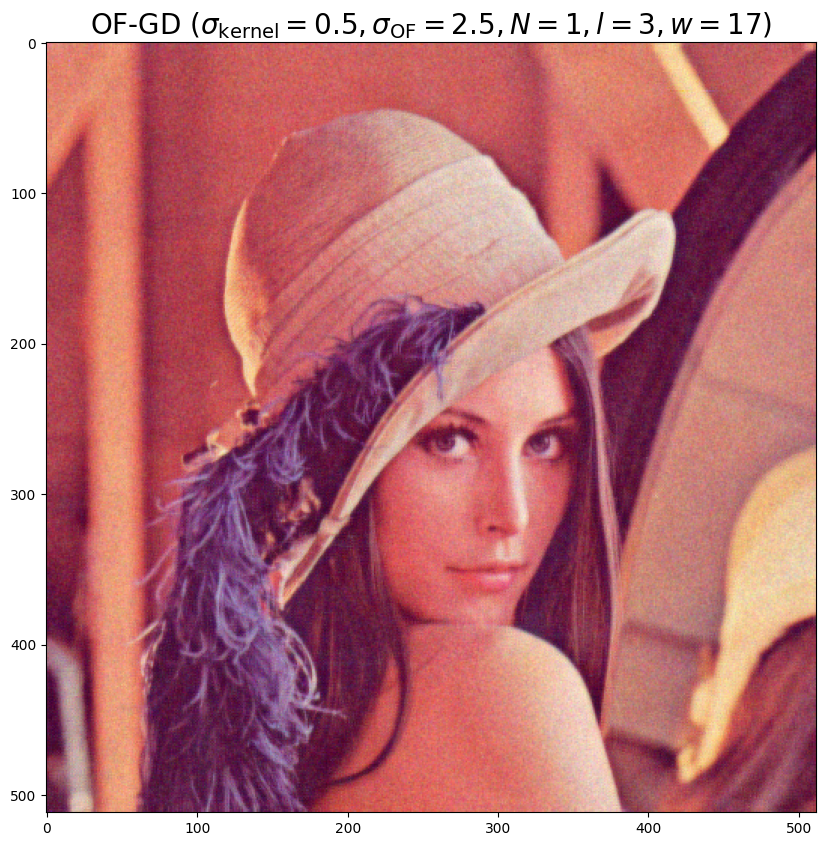

In [33]:
RGB_image.show(denoised.astype(np.uint8), "OF-GD " + "($\sigma_\mathrm{kernel}=" + f"{OFGD__sigma_kernel}"  + ", \sigma_\mathrm{OF}=" + f"{OFGD__sigma_OF}" + f", N={OFGD__N_iters}, l={OFGD__l}, w={OFGD__w}$)")

In [34]:
%%time

OFGD__sigma_kernel = 0.5
OFGD__N_iters = 1
OFGD__l = 3
OFGD__w = 7
OFGD__sigma_OF = 2.5

denoised, _ = image_denoising.OF_gaussian.filter_RGB_image(noisy_img, OFGD__sigma_kernel, OFGD__N_iters, OFGD__l, OFGD__w, OFGD__sigma_OF)

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 27

[image_3.py:87 print_stats() INFO] component=0 max=254 min=52 avg=178.96812438964844
[image_3.py:87 print_stats() INFO] component=1 max=239 min=1 avg=98.3066177368164
[image_3.py:87 print_stats() INFO] component=2 max=228 min=24 avg=104.53642654418945


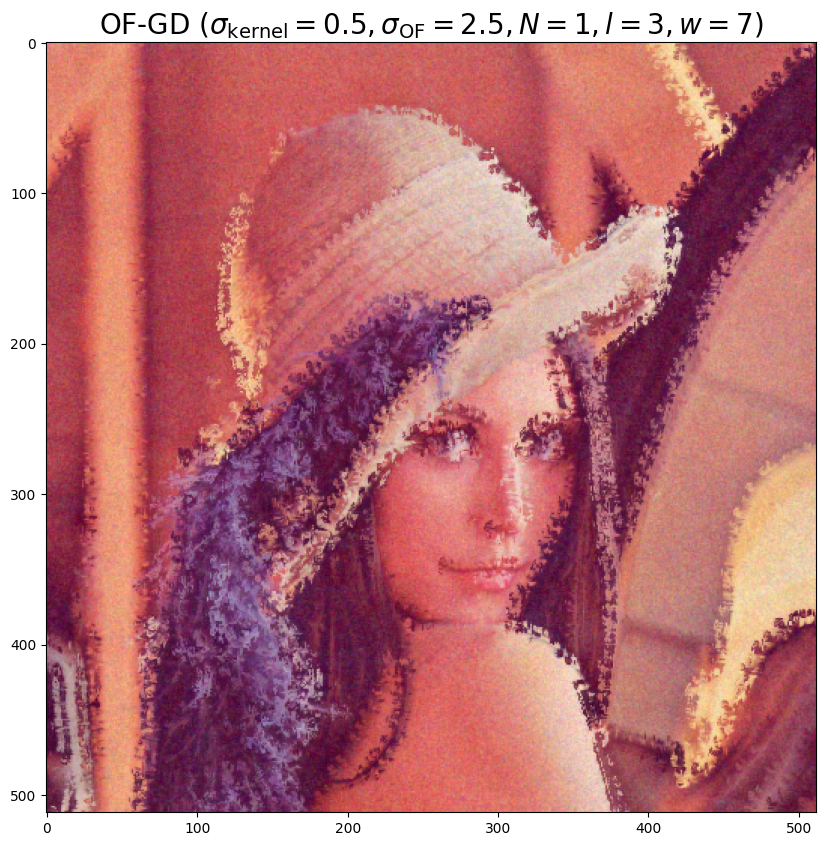

In [35]:
RGB_image.show(denoised.astype(np.uint8), "OF-GD " + "($\sigma_\mathrm{kernel}=" + f"{OFGD__sigma_kernel}"  + ", \sigma_\mathrm{OF}=" + f"{OFGD__sigma_OF}" + f", N={OFGD__N_iters}, l={OFGD__l}, w={OFGD__w}$)")

In [36]:
%%time

OFGD__sigma_kernel = 3.5
OFGD__N_iters = 1
OFGD__l = 3
OFGD__w = 15
OFGD__sigma_OF = 2.5

denoised, _ = image_denoising.OF_gaussian.filter_RGB_image(noisy_img, OFGD__sigma_kernel, OFGD__N_iters, OFGD__l, OFGD__w, OFGD__sigma_OF)

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 27

[image_3.py:87 print_stats() INFO] component=0 max=244 min=84 avg=179.35462188720703
[image_3.py:87 print_stats() INFO] component=1 max=211 min=14 avg=98.42481231689453
[image_3.py:87 print_stats() INFO] component=2 max=192 min=54 avg=104.59585952758789


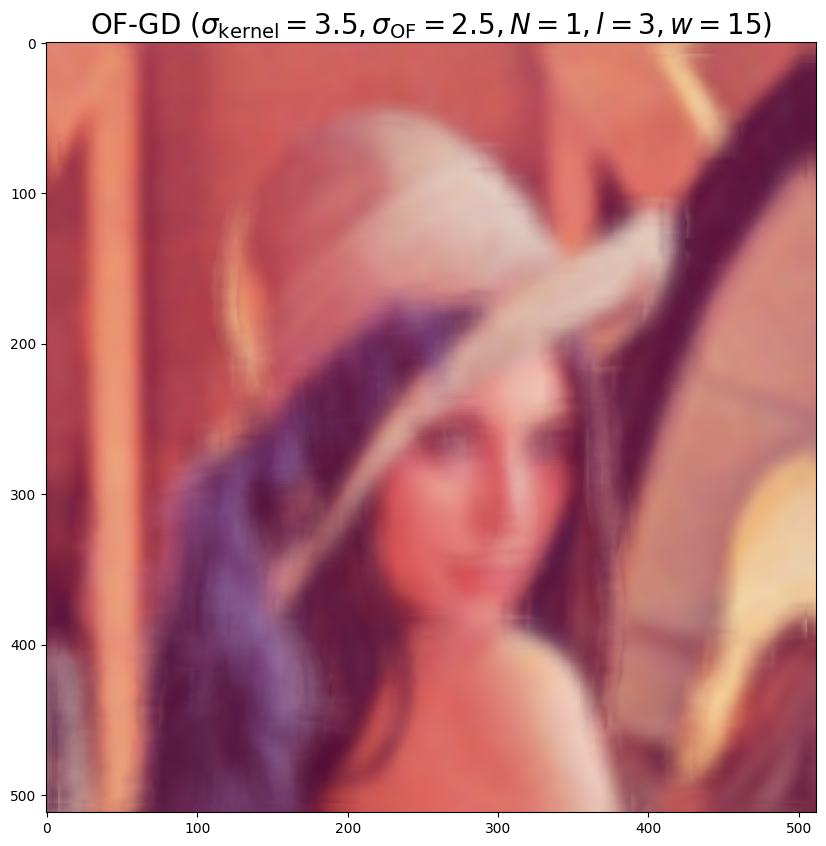

In [37]:
RGB_image.show(denoised.astype(np.uint8), "OF-GD " + "($\sigma_\mathrm{kernel}=" + f"{OFGD__sigma_kernel}"  + ", \sigma_\mathrm{OF}=" + f"{OFGD__sigma_OF}" + f", N={OFGD__N_iters}, l={OFGD__l}, w={OFGD__w}$)")

## OF-driven Random

In [38]:
import image_denoising
from image_denoising import OF_random
image_denoising.OF_random.logger.setLevel(logging.WARNING)
logging.getLevelName(image_denoising.OF_random.logger.getEffectiveLevel())

'WARNING'

In [39]:
%%time

OFRD__N_iters = 50
OFRD__sigma_random = 1.0
OFRD__l = 3
OFRD__w = 11
OFRD__sigma_OF = 0.25

denoised, _ = image_denoising.OF_random.denoise(
    image_denoising.OF_random.RGB_warp_B_to_A,
    noisy_img,
    N_iters=OFRD__N_iters,
    sigma_RD=OFRD__sigma_random,
    l=OFRD__l,
    w=OFRD__w,
    sigma_OF=OFRD__sigma_OF)

0/50 1/50 2/50 3/50 4/50 5/50 6/50 7/50 8/50 9/50 10/50 11/50 12/50 13/50 14/50 15/50 16/50 17/50 18/50 19/50 20/50 21/50 22/50 23/50 24/50 25/50 26/50 27/50 28/50 29/50 30/50 31/50 32/50 33/50 34/50 35/50 36/50 37/50 38/50 39/50 40/50 41/50 42/50 43/50 44/50 45/50 46/50 47/50 48/50 49/50 
CPU times: user 7.1 s, sys: 327 ms, total: 7.43 s
Wall time: 6.86 s


[image_3.py:87 print_stats() INFO] component=0 max=252 min=57 avg=181.12754821777344
[image_3.py:87 print_stats() INFO] component=1 max=231 min=4 avg=100.65340423583984
[image_3.py:87 print_stats() INFO] component=2 max=218 min=42 avg=105.94632720947266


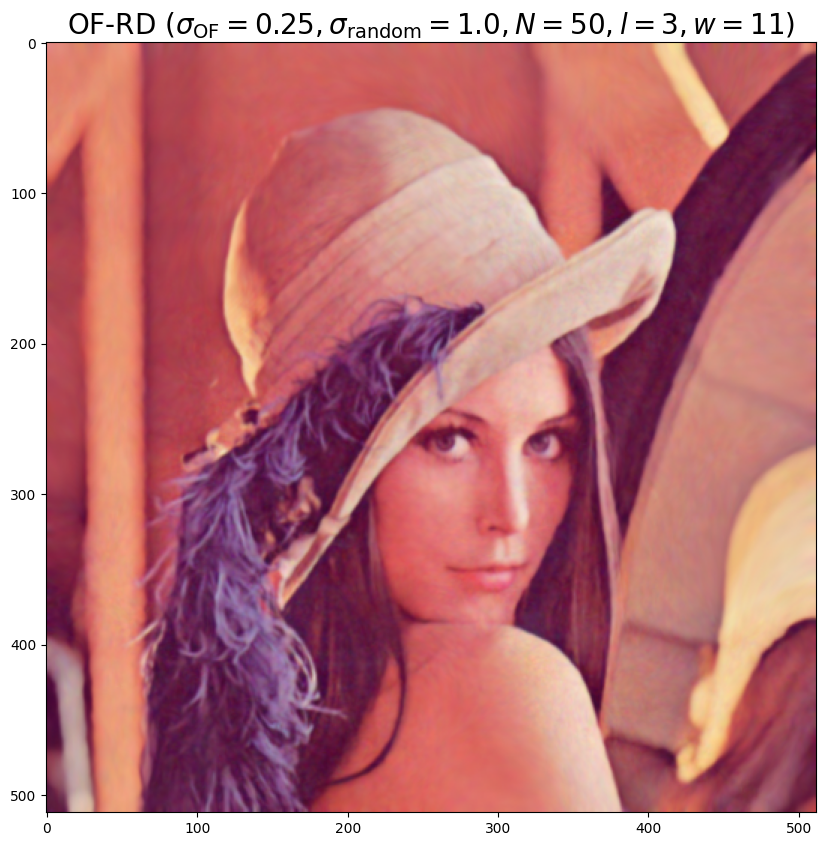

In [40]:
RGB_image.show(denoised.astype(np.uint8), "OF-RD " + "($\sigma_\mathrm{OF}=" + f"{OFRD__sigma_OF}, " + "\sigma_\mathrm{random}=" + f"{OFRD__sigma_random}, " + f"N={OFRD__N_iters}, l={OFRD__l}, w={OFRD__w}$)")

In [41]:
%%time

OFRD__N_iters = 50
OFRD__sigma_random = 1.0
OFRD__l = 3
OFRD__w = 11
OFRD__sigma_OF = 1.25

denoised, _ = image_denoising.OF_random.denoise(
    image_denoising.OF_random.RGB_warp_B_to_A,
    noisy_img,
    N_iters=OFRD__N_iters,
    sigma_RD=OFRD__sigma_random,
    l=OFRD__l,
    w=OFRD__w,
    sigma_OF=OFRD__sigma_OF)

0/50 1/50 2/50 3/50 4/50 5/50 6/50 7/50 8/50 9/50 10/50 11/50 12/50 13/50 14/50 15/50 16/50 17/50 18/50 19/50 20/50 21/50 22/50 23/50 24/50 25/50 26/50 27/50 28/50 29/50 30/50 31/50 32/50 33/50 34/50 35/50 36/50 37/50 38/50 39/50 40/50 41/50 42/50 43/50 44/50 45/50 46/50 47/50 48/50 49/50 
CPU times: user 7.12 s, sys: 366 ms, total: 7.48 s
Wall time: 6.91 s


[image_3.py:87 print_stats() INFO] component=0 max=248 min=60 avg=179.83528900146484
[image_3.py:87 print_stats() INFO] component=1 max=223 min=1 avg=99.28033447265625
[image_3.py:87 print_stats() INFO] component=2 max=208 min=34 avg=105.28316879272461


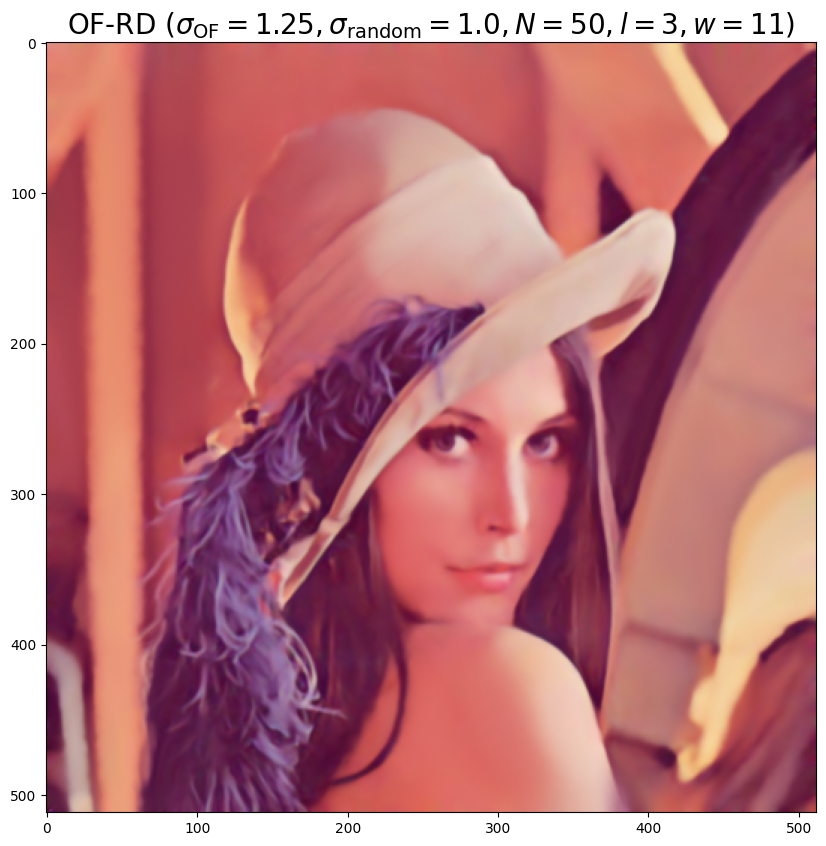

In [42]:
RGB_image.show(denoised.astype(np.uint8), "OF-RD " + "($\sigma_\mathrm{OF}=" + f"{OFRD__sigma_OF}, " + "\sigma_\mathrm{random}=" + f"{OFRD__sigma_random}, " + f"N={OFRD__N_iters}, l={OFRD__l}, w={OFRD__w}$)")

In [43]:
%%time

OFRD__N_iters = 50
OFRD__sigma_random = 0.5
OFRD__l = 3
OFRD__w = 11
OFRD__sigma_OF = 0.25

denoised, _ = image_denoising.OF_random.denoise(
    image_denoising.OF_random.RGB_warp_B_to_A,
    noisy_img,
    N_iters=OFRD__N_iters,
    sigma_RD=OFRD__sigma_random,
    l=OFRD__l,
    w=OFRD__w,
    sigma_OF=OFRD__sigma_OF)

0/50 1/50 2/50 3/50 4/50 5/50 6/50 7/50 8/50 9/50 10/50 11/50 12/50 13/50 14/50 15/50 16/50 17/50 18/50 19/50 20/50 21/50 22/50 23/50 24/50 25/50 26/50 27/50 28/50 29/50 30/50 31/50 32/50 33/50 34/50 35/50 36/50 37/50 38/50 39/50 40/50 41/50 42/50 43/50 44/50 45/50 46/50 47/50 48/50 49/50 
CPU times: user 7.06 s, sys: 381 ms, total: 7.44 s
Wall time: 6.88 s


[image_3.py:87 print_stats() INFO] component=0 max=252 min=50 avg=179.62838745117188
[image_3.py:87 print_stats() INFO] component=1 max=233 min=2 avg=98.89164733886719
[image_3.py:87 print_stats() INFO] component=2 max=218 min=30 avg=104.86500549316406


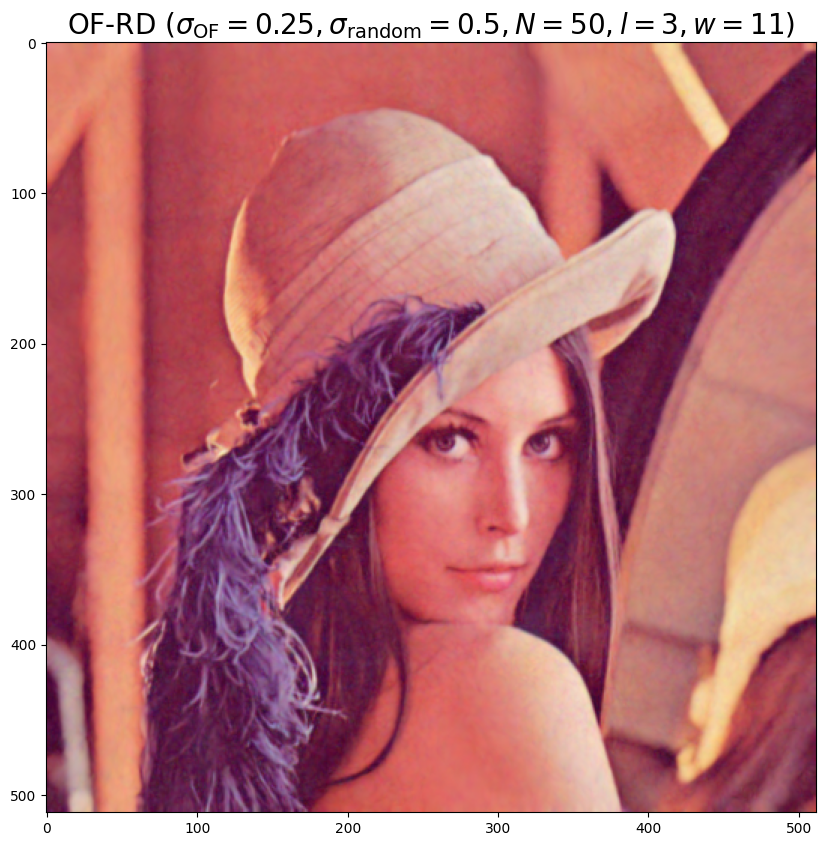

In [44]:
RGB_image.show(denoised.astype(np.uint8), "OF-RD " + "($\sigma_\mathrm{OF}=" + f"{OFRD__sigma_OF}, " + "\sigma_\mathrm{random}=" + f"{OFRD__sigma_random}, " + f"N={OFRD__N_iters}, l={OFRD__l}, w={OFRD__w}$)")

In [45]:
%%time

OFRD__N_iters = 100
OFRD__sigma_random = 0.5
OFRD__l = 3
OFRD__w = 11
OFRD__sigma_OF = 0.25

denoised, _ = image_denoising.OF_random.denoise(
    image_denoising.OF_random.RGB_warp_B_to_A,
    noisy_img,
    N_iters=OFRD__N_iters,
    sigma_RD=OFRD__sigma_random,
    l=OFRD__l,
    w=OFRD__w,
    sigma_OF=OFRD__sigma_OF)

0/100 1/100 2/100 3/100 4/100 5/100 6/100 7/100 8/100 9/100 10/100 11/100 12/100 13/100 14/100 15/100 16/100 17/100 18/100 19/100 20/100 21/100 22/100 23/100 24/100 25/100 26/100 27/100 28/100 29/100 30/100 31/100 32/100 33/100 34/100 35/100 36/100 37/100 38/100 39/100 40/100 41/100 42/100 43/100 44/100 45/100 46/100 47/100 48/100 49/100 50/100 51/100 52/100 53/100 54/100 55/100 56/100 57/100 58/100 59/100 60/100 61/100 62/100 63/100 64/100 65/100 66/100 67/100 68/100 69/100 70/100 71/100 72/100 73/100 74/100 75/100 76/100 77/100 78/100 79/100 80/100 81/100 82/100 83/100 84/100 85/100 86/100 87/100 88/100 89/100 90/100 91/100 92/100 93/100 94/100 95/100 96/100 97/100 98/100 99/100 
CPU times: user 14.3 s, sys: 1.01 s, total: 15.3 s
Wall time: 14.1 s


[image_3.py:87 print_stats() INFO] component=0 max=252 min=50 avg=179.66709518432617
[image_3.py:87 print_stats() INFO] component=1 max=230 min=2 avg=98.95425033569336
[image_3.py:87 print_stats() INFO] component=2 max=217 min=36 avg=104.92438507080078


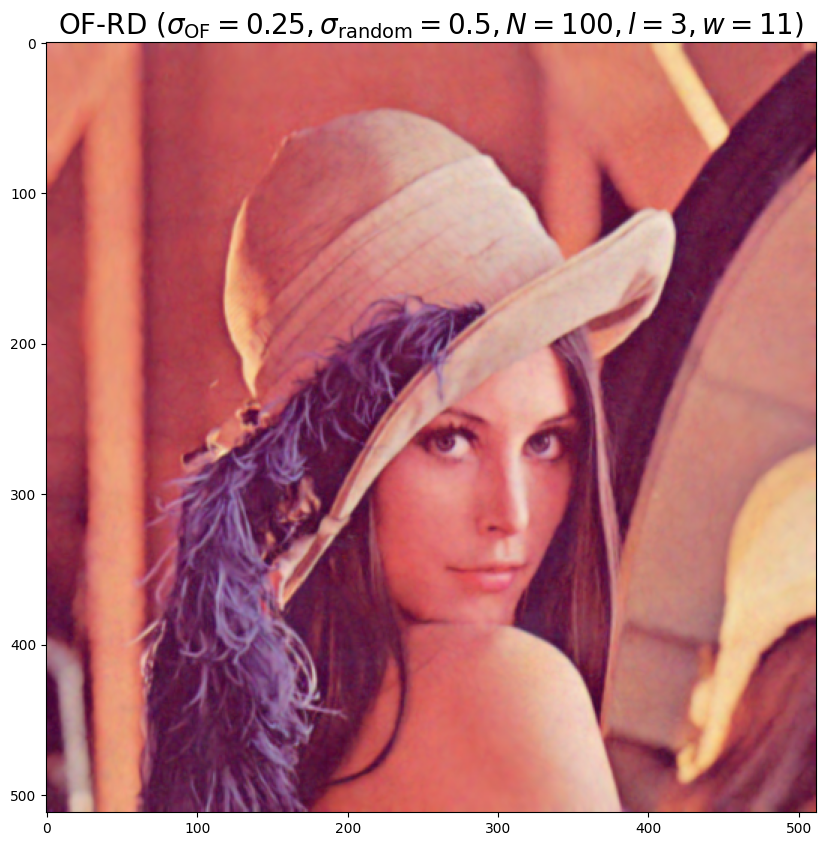

In [46]:
RGB_image.show(denoised.astype(np.uint8), "OF-RD " + "($\sigma_\mathrm{OF}=" + f"{OFRD__sigma_OF}, " + "\sigma_\mathrm{random}=" + f"{OFRD__sigma_random}, " + f"N={OFRD__N_iters}, l={OFRD__l}, w={OFRD__w}$)")

In [47]:
%%time

OFRD__N_iters = 50
OFRD__sigma_random = 1.0
OFRD__l = 3
OFRD__w = 3
OFRD__sigma_OF = 0.25

denoised, _ = image_denoising.OF_random.denoise(
    image_denoising.OF_random.RGB_warp_B_to_A,
    noisy_img,
    N_iters=OFRD__N_iters,
    sigma_RD=OFRD__sigma_random,
    l=OFRD__l,
    w=OFRD__w,
    sigma_OF=OFRD__sigma_OF)

0/50 1/50 2/50 3/50 4/50 5/50 6/50 7/50 8/50 9/50 10/50 11/50 12/50 13/50 14/50 15/50 16/50 17/50 18/50 19/50 20/50 21/50 22/50 23/50 24/50 25/50 26/50 27/50 28/50 29/50 30/50 31/50 32/50 33/50 34/50 35/50 36/50 37/50 38/50 39/50 40/50 41/50 42/50 43/50 44/50 45/50 46/50 47/50 48/50 49/50 
CPU times: user 6.85 s, sys: 613 ms, total: 7.46 s
Wall time: 6.86 s


[image_3.py:87 print_stats() INFO] component=0 max=239 min=62 avg=175.82835388183594
[image_3.py:87 print_stats() INFO] component=1 max=186 min=5 avg=95.85689544677734
[image_3.py:87 print_stats() INFO] component=2 max=160 min=33 avg=103.8949966430664


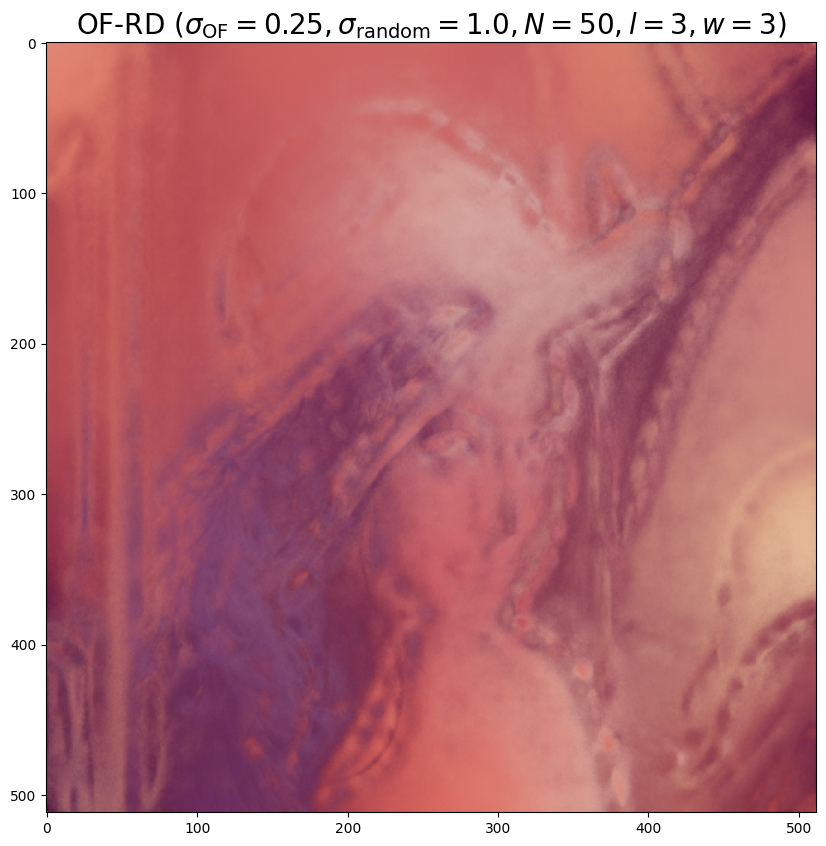

In [48]:
RGB_image.show(denoised.astype(np.uint8), "OF-RD " + "($\sigma_\mathrm{OF}=" + f"{OFRD__sigma_OF}, " + "\sigma_\mathrm{random}=" + f"{OFRD__sigma_random}, " + f"N={OFRD__N_iters}, l={OFRD__l}, w={OFRD__w}$)")

In [49]:
%%time

OFRD__N_iters = 50
OFRD__sigma_random = 0.5
OFRD__l = 1
OFRD__w = 3
OFRD__sigma_OF = 0.25

denoised, _ = image_denoising.OF_random.denoise(
    image_denoising.OF_random.RGB_warp_B_to_A,
    noisy_img,
    N_iters=OFRD__N_iters,
    sigma_RD=OFRD__sigma_random,
    l=OFRD__l,
    w=OFRD__w,
    sigma_OF=OFRD__sigma_OF)

0/50 1/50 2/50 3/50 4/50 5/50 6/50 7/50 8/50 9/50 10/50 11/50 12/50 13/50 14/50 15/50 16/50 17/50 18/50 19/50 20/50 21/50 22/50 23/50 24/50 25/50 26/50 27/50 28/50 29/50 30/50 31/50 32/50 33/50 34/50 35/50 36/50 37/50 38/50 39/50 40/50 41/50 42/50 43/50 44/50 45/50 46/50 47/50 48/50 49/50 
CPU times: user 6.55 s, sys: 412 ms, total: 6.96 s
Wall time: 6.36 s


[image_3.py:87 print_stats() INFO] component=0 max=248 min=62 avg=178.4756851196289
[image_3.py:87 print_stats() INFO] component=1 max=204 min=2 avg=97.73503494262695
[image_3.py:87 print_stats() INFO] component=2 max=181 min=33 avg=104.20853042602539


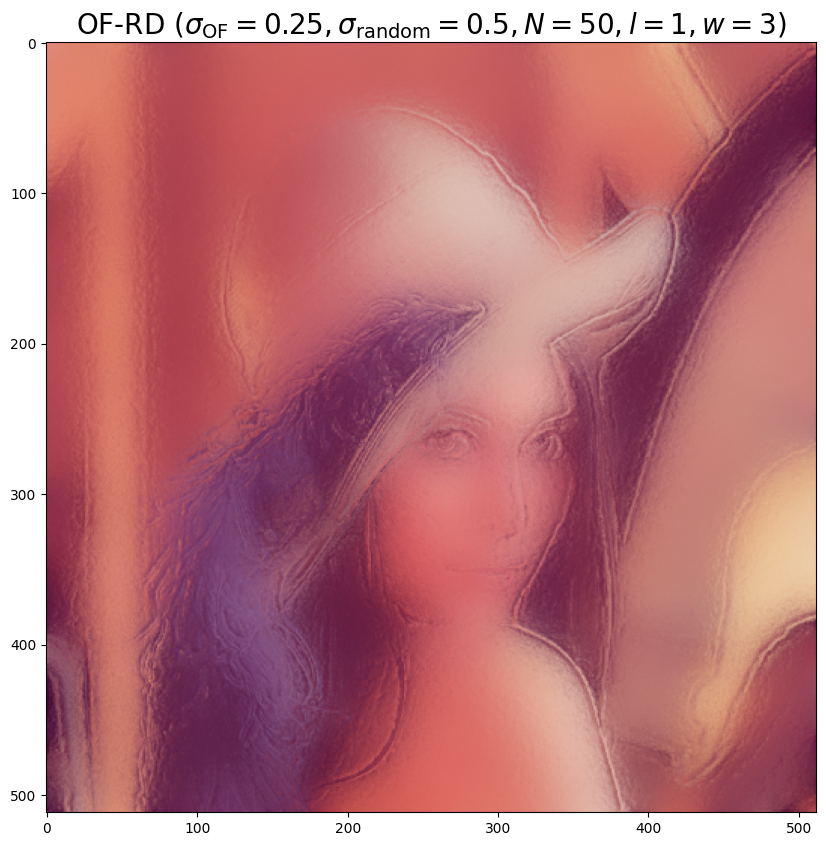

In [50]:
RGB_image.show(denoised.astype(np.uint8), "OF-RD " + "($\sigma_\mathrm{OF}=" + f"{OFRD__sigma_OF}, " + "\sigma_\mathrm{random}=" + f"{OFRD__sigma_random}, " + f"N={OFRD__N_iters}, l={OFRD__l}, w={OFRD__w}$)")

In [51]:
%%time

OFRD__N_iters = 50
OFRD__sigma_random = 0.5
OFRD__l = 1
OFRD__w = 5
OFRD__sigma_OF = 0.25

denoised, _ = image_denoising.OF_random.denoise(
    image_denoising.OF_random.RGB_warp_B_to_A,
    noisy_img,
    N_iters=OFRD__N_iters,
    sigma_RD=OFRD__sigma_random,
    l=OFRD__l,
    w=OFRD__w,
    sigma_OF=OFRD__sigma_OF)

0/50 1/50 2/50 3/50 4/50 5/50 6/50 7/50 8/50 9/50 10/50 11/50 12/50 13/50 14/50 15/50 16/50 17/50 18/50 19/50 20/50 21/50 22/50 23/50 24/50 25/50 26/50 27/50 28/50 29/50 30/50 31/50 32/50 33/50 34/50 35/50 36/50 37/50 38/50 39/50 40/50 41/50 42/50 43/50 44/50 45/50 46/50 47/50 48/50 49/50 
CPU times: user 6.44 s, sys: 366 ms, total: 6.8 s
Wall time: 6.23 s


[image_3.py:87 print_stats() INFO] component=0 max=246 min=55 avg=179.07444381713867
[image_3.py:87 print_stats() INFO] component=1 max=220 min=2 avg=98.14822769165039
[image_3.py:87 print_stats() INFO] component=2 max=204 min=39 avg=104.45426177978516


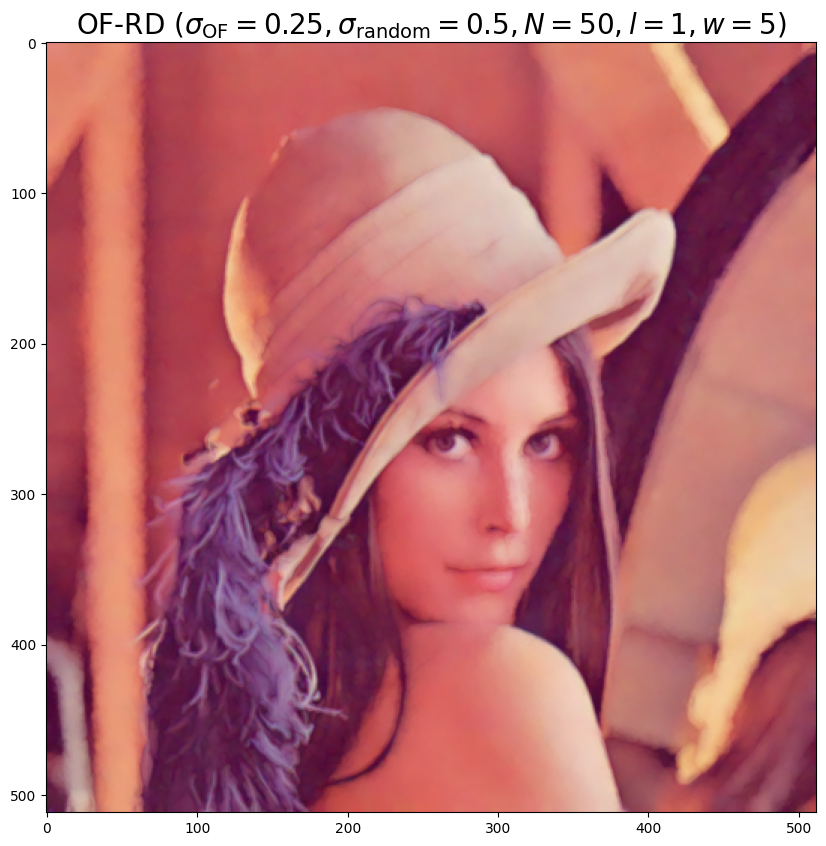

In [52]:
RGB_image.show(denoised.astype(np.uint8), "OF-RD " + "($\sigma_\mathrm{OF}=" + f"{OFRD__sigma_OF}, " + "\sigma_\mathrm{random}=" + f"{OFRD__sigma_random}, " + f"N={OFRD__N_iters}, l={OFRD__l}, w={OFRD__w}$)")

In [53]:
%%time

OFRD__N_iters = 50
OFRD__sigma_random = 0.5
OFRD__l = 1
OFRD__w = 17
OFRD__sigma_OF = 0.25

denoised, _ = image_denoising.OF_random.denoise(
    image_denoising.OF_random.RGB_warp_B_to_A,
    noisy_img,
    N_iters=OFRD__N_iters,
    sigma_RD=OFRD__sigma_random,
    l=OFRD__l,
    w=OFRD__w,
    sigma_OF=OFRD__sigma_OF)

0/50 1/50 2/50 3/50 4/50 5/50 6/50 7/50 8/50 9/50 10/50 11/50 12/50 13/50 14/50 15/50 16/50 17/50 18/50 19/50 20/50 21/50 22/50 23/50 24/50 25/50 26/50 27/50 28/50 29/50 30/50 31/50 32/50 33/50 34/50 35/50 36/50 37/50 38/50 39/50 40/50 41/50 42/50 43/50 44/50 45/50 46/50 47/50 48/50 49/50 
CPU times: user 4.43 s, sys: 217 ms, total: 4.65 s
Wall time: 4.1 s


[image_3.py:87 print_stats() INFO] component=0 max=253 min=46 avg=179.57755661010742
[image_3.py:87 print_stats() INFO] component=1 max=236 min=0 avg=98.81441497802734
[image_3.py:87 print_stats() INFO] component=2 max=224 min=23 avg=104.81505584716797


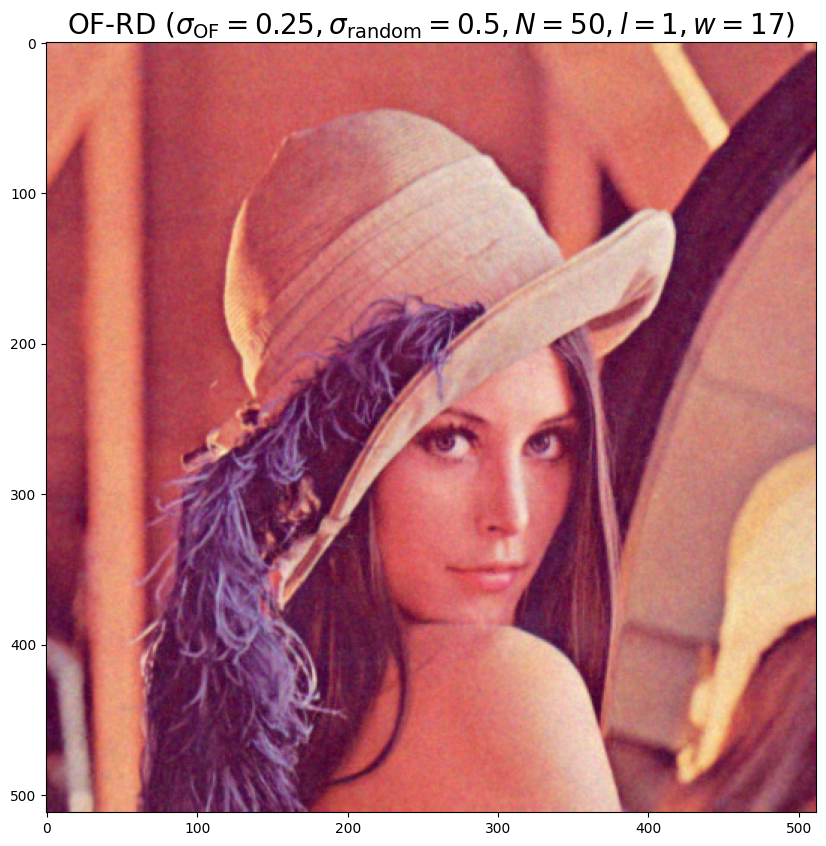

In [54]:
RGB_image.show(denoised.astype(np.uint8), "OF-RD " + "($\sigma_\mathrm{OF}=" + f"{OFRD__sigma_OF}, " + "\sigma_\mathrm{random}=" + f"{OFRD__sigma_random}, " + f"N={OFRD__N_iters}, l={OFRD__l}, w={OFRD__w}$)")

In [55]:
%%time

OFRD__N_iters = 100
OFRD__sigma_random = 0.5
OFRD__l = 1
OFRD__w = 17
OFRD__sigma_OF = 0.25

denoised, _ = image_denoising.OF_random.denoise(
    image_denoising.OF_random.RGB_warp_B_to_A,
    noisy_img,
    N_iters=OFRD__N_iters,
    sigma_RD=OFRD__sigma_random,
    l=OFRD__l,
    w=OFRD__w,
    sigma_OF=OFRD__sigma_OF)

0/100 1/100 2/100 3/100 4/100 5/100 6/100 7/100 8/100 9/100 10/100 11/100 12/100 13/100 14/100 15/100 16/100 17/100 18/100 19/100 20/100 21/100 22/100 23/100 24/100 25/100 26/100 27/100 28/100 29/100 30/100 31/100 32/100 33/100 34/100 35/100 36/100 37/100 38/100 39/100 40/100 41/100 42/100 43/100 44/100 45/100 46/100 47/100 48/100 49/100 50/100 51/100 52/100 53/100 54/100 55/100 56/100 57/100 58/100 59/100 60/100 61/100 62/100 63/100 64/100 65/100 66/100 67/100 68/100 69/100 70/100 71/100 72/100 73/100 74/100 75/100 76/100 77/100 78/100 79/100 80/100 81/100 82/100 83/100 84/100 85/100 86/100 87/100 88/100 89/100 90/100 91/100 92/100 93/100 94/100 95/100 96/100 97/100 98/100 99/100 
CPU times: user 8.82 s, sys: 422 ms, total: 9.25 s
Wall time: 8.14 s


[image_3.py:87 print_stats() INFO] component=0 max=253 min=48 avg=179.64902877807617
[image_3.py:87 print_stats() INFO] component=1 max=234 min=1 avg=98.91127395629883
[image_3.py:87 print_stats() INFO] component=2 max=222 min=23 avg=104.86685562133789


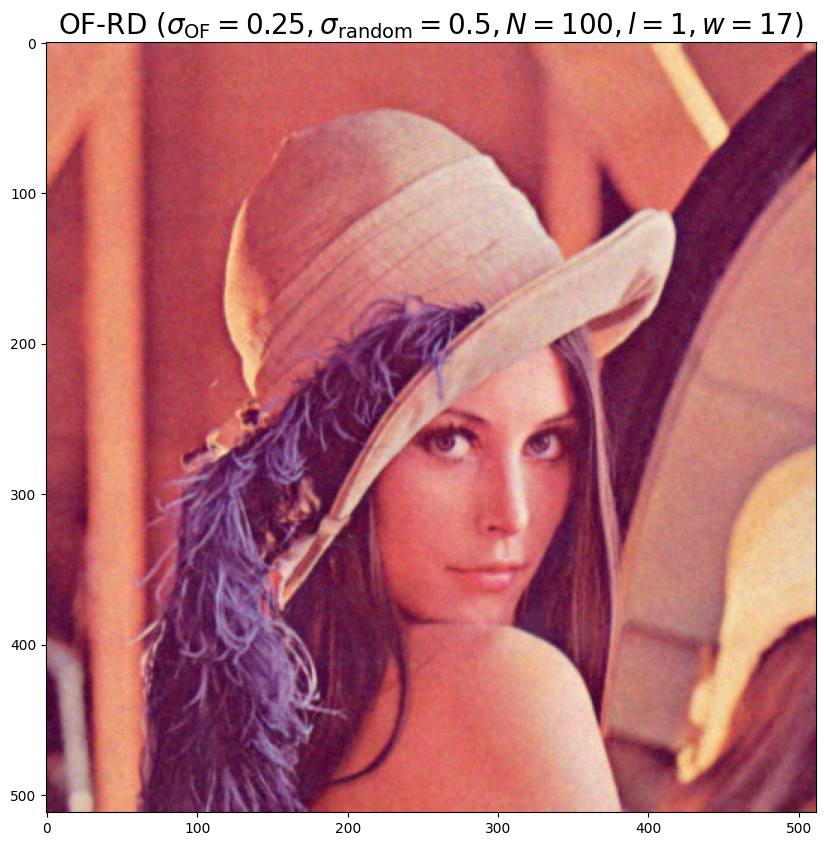

In [56]:
RGB_image.show(denoised.astype(np.uint8), "OF-RD " + "($\sigma_\mathrm{OF}=" + f"{OFRD__sigma_OF}, " + "\sigma_\mathrm{random}=" + f"{OFRD__sigma_random}, " + f"N={OFRD__N_iters}, l={OFRD__l}, w={OFRD__w}$)")

In [57]:
%%time

OFRD__N_iters = 100
OFRD__sigma_random = 0.5
OFRD__l = 1
OFRD__w = 17
OFRD__sigma_OF = 0.75

denoised, _ = image_denoising.OF_random.denoise(
    image_denoising.OF_random.RGB_warp_B_to_A,
    noisy_img,
    N_iters=OFRD__N_iters,
    sigma_RD=OFRD__sigma_random,
    l=OFRD__l,
    w=OFRD__w,
    sigma_OF=OFRD__sigma_OF)

0/100 1/100 2/100 3/100 4/100 5/100 6/100 7/100 8/100 9/100 10/100 11/100 12/100 13/100 14/100 15/100 16/100 17/100 18/100 19/100 20/100 21/100 22/100 23/100 24/100 25/100 26/100 27/100 28/100 29/100 30/100 31/100 32/100 33/100 34/100 35/100 36/100 37/100 38/100 39/100 40/100 41/100 42/100 43/100 44/100 45/100 46/100 47/100 48/100 49/100 50/100 51/100 52/100 53/100 54/100 55/100 56/100 57/100 58/100 59/100 60/100 61/100 62/100 63/100 64/100 65/100 66/100 67/100 68/100 69/100 70/100 71/100 72/100 73/100 74/100 75/100 76/100 77/100 78/100 79/100 80/100 81/100 82/100 83/100 84/100 85/100 86/100 87/100 88/100 89/100 90/100 91/100 92/100 93/100 94/100 95/100 96/100 97/100 98/100 99/100 
CPU times: user 8.65 s, sys: 864 ms, total: 9.52 s
Wall time: 8.41 s


[image_3.py:87 print_stats() INFO] component=0 max=253 min=50 avg=179.54032516479492
[image_3.py:87 print_stats() INFO] component=1 max=233 min=2 avg=98.78446578979492
[image_3.py:87 print_stats() INFO] component=2 max=223 min=30 avg=104.80262756347656


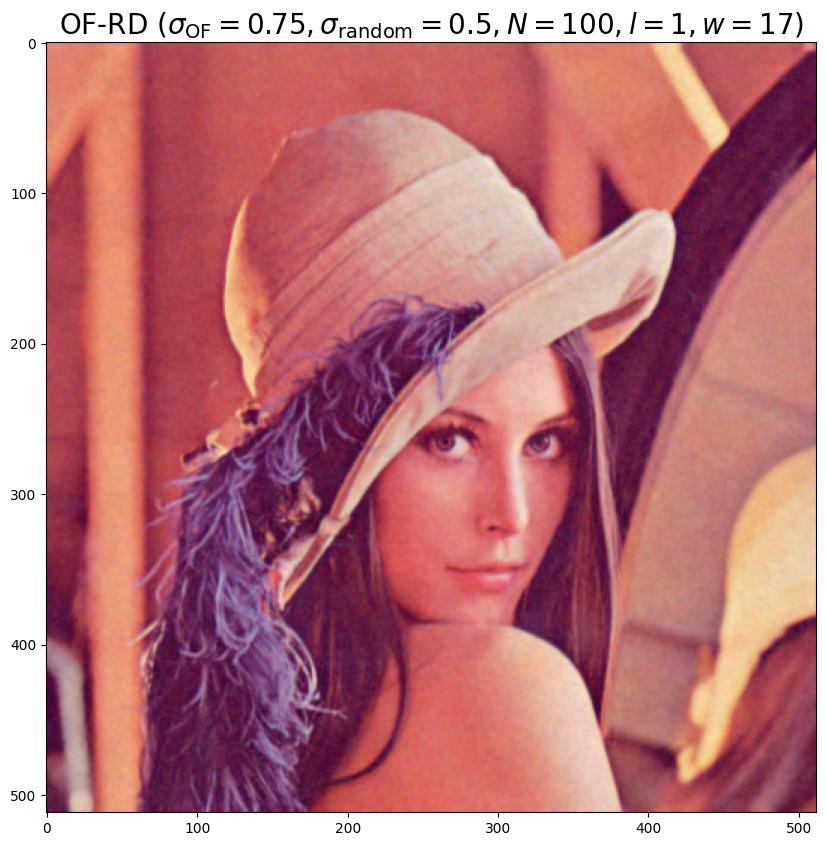

In [58]:
RGB_image.show(denoised.astype(np.uint8), "OF-RD " + "($\sigma_\mathrm{OF}=" + f"{OFRD__sigma_OF}, " + "\sigma_\mathrm{random}=" + f"{OFRD__sigma_random}, " + f"N={OFRD__N_iters}, l={OFRD__l}, w={OFRD__w}$)")

In [59]:
%%time

OFRD__N_iters = 100
OFRD__sigma_random = 0.5
OFRD__l = 1
OFRD__w = 17
OFRD__sigma_OF = 0.75

denoised, _ = image_denoising.OF_random.denoise(
    image_denoising.OF_random.RGB_warp_B_to_A,
    noisy_img,
    N_iters=OFRD__N_iters,
    sigma_RD=OFRD__sigma_random,
    l=OFRD__l,
    w=OFRD__w,
    sigma_OF=OFRD__sigma_OF)

0/100 1/100 2/100 3/100 4/100 5/100 6/100 7/100 8/100 9/100 10/100 11/100 12/100 13/100 14/100 15/100 16/100 17/100 18/100 19/100 20/100 21/100 22/100 23/100 24/100 25/100 26/100 27/100 28/100 29/100 30/100 31/100 32/100 33/100 34/100 35/100 36/100 37/100 38/100 39/100 40/100 41/100 42/100 43/100 44/100 45/100 46/100 47/100 48/100 49/100 50/100 51/100 52/100 53/100 54/100 55/100 56/100 57/100 58/100 59/100 60/100 61/100 62/100 63/100 64/100 65/100 66/100 67/100 68/100 69/100 70/100 71/100 72/100 73/100 74/100 75/100 76/100 77/100 78/100 79/100 80/100 81/100 82/100 83/100 84/100 85/100 86/100 87/100 88/100 89/100 90/100 91/100 92/100 93/100 94/100 95/100 96/100 97/100 98/100 99/100 
CPU times: user 8.55 s, sys: 784 ms, total: 9.33 s
Wall time: 8.22 s


[image_3.py:87 print_stats() INFO] component=0 max=252 min=47 avg=179.53933715820312
[image_3.py:87 print_stats() INFO] component=1 max=234 min=1 avg=98.79174041748047
[image_3.py:87 print_stats() INFO] component=2 max=220 min=32 avg=104.80062103271484


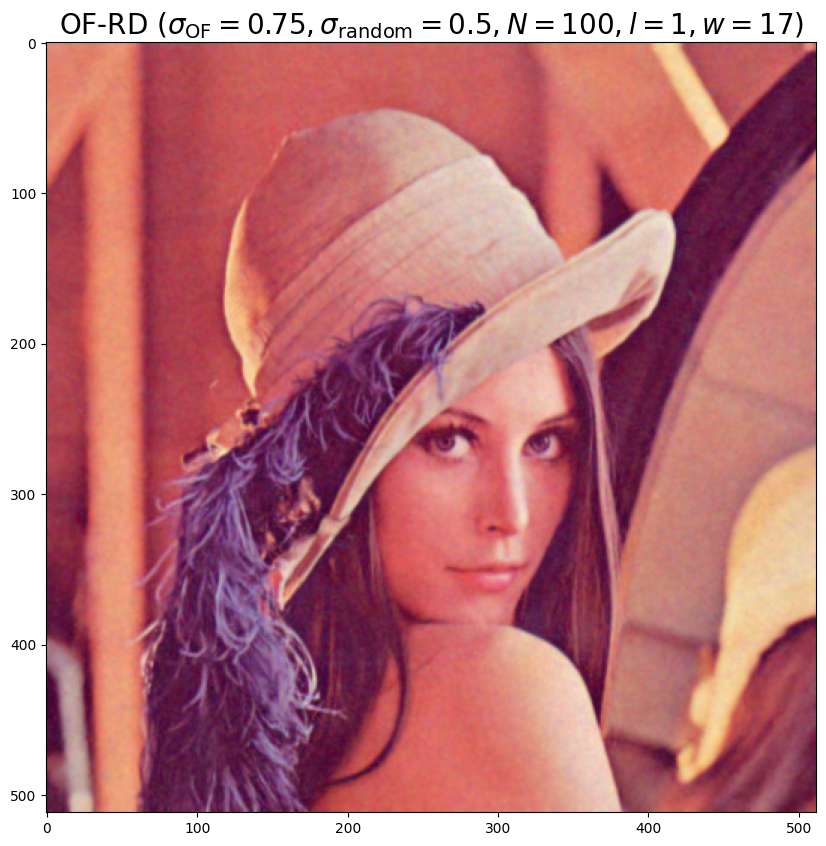

In [60]:
RGB_image.show(denoised.astype(np.uint8), "OF-RD " + "($\sigma_\mathrm{OF}=" + f"{OFRD__sigma_OF}, " + "\sigma_\mathrm{random}=" + f"{OFRD__sigma_random}, " + f"N={OFRD__N_iters}, l={OFRD__l}, w={OFRD__w}$)")

In [ ]:
input()

## Old stuff

In [ ]:
denoised_img = _2D_OF_denoising.filter(noisy_img, kernel, l=1, w=33)

In [ ]:
gray_image.show(denoised_img, "denoised")

In [ ]:
print(f"time: {time.process_time()} seconds")

In [ ]:
!pip install mrcfile
import mrcfile

In [ ]:
input_format = "rec"
tomogram_name = "/home/vruiz/Descargas/TS01-wbp"
tomogram_MRC = mrcfile.open(f'{tomogram_name}.{input_format}')
print(f"tomogram_name={tomogram_name} type={tomogram_MRC.data.dtype} shape={tomogram_MRC.data.shape}")
tomogram = tomogram_MRC.data

In [ ]:
denoised_tomogram = _2D_OF_denoising.filter_over_Y(tomogram, kernel, l=2, w=3)

In [ ]:
import matplotlib.pyplot as plt
from ipywidgets import *
import cv2

In [ ]:
def g(z=0):
  #cv2_imshow(cv2.normalize(tomogram[z, :, :][0:200,0:200].astype(np.uint8), None, 0, 255, cv2.NORM_MINMAX))
  #cv2_imshow(cv2.normalize(tomogram[z, :, :].astype(np.uint8), None, 0, 255, cv2.NORM_MINMAX))
  plt.imshow(cv2.normalize(tomogram[z, :, :], None, 0, 255, cv2.NORM_MINMAX))
  plt.imshow(cv2.normalize(denoised_tomogram[z, :, :], None, 0, 255, cv2.NORM_MINMAX))

interactive_plot = interactive(g, z=100)
interactive_plot

In [ ]:
fake_tomogram = np.stack([np.roll(noisy_img,0) for i in range(64)])

In [ ]:
def g(z=0):
  plt.imshow(cv2.normalize(fake_tomogram[:, z, :], None, 0, 255, cv2.NORM_MINMAX))

interactive_plot = interactive(g, z=10)
interactive_plot

In [ ]:
fake_denoised_tomogram = _2D_OF_denoising.filter_over_X(fake_tomogram, kernel, l=2, w=3)

In [ ]:
try:
    import optical_flow as motion
    import display
    import prediction
except:
    !pip install "motion_estimation @ git+https://github.com/vicente-gonzalez-ruiz/motion_estimation"
    from motion_estimation import optical_flow as motion
    from motion_estimation import display
    from motion_estimation import prediction

In [ ]:
initial_MVs = np.zeros((fake_tomogram[:, 0, :].shape[0], fake_tomogram[:, 0, :].shape[1], 2), dtype=np.float32)
MVs = motion.Farneback_ME(predicted=fake_tomogram[:, 10, :], reference=fake_tomogram[:, 15, :], initial_MVs=initial_MVs)

In [ ]:
#display.show_vectors(MVs[::1, ::1])
display.show_vectors(MVs)

In [ ]:
np.max(MVs)

In [ ]:
MVs[32,...]

In [ ]:
initial_MVs = np.zeros((tomogram[:, 0, :].shape[0], tomogram[:, 0, :].shape[1], 2), dtype=np.float32)
MVs = motion.Farneback_ME(predicted=tomogram[:, 1, :], reference=tomogram[:, 2, :], initial_MVs=initial_MVs)

In [ ]:
np.max(MVs)

In [ ]:
tomogram.dtype

In [ ]:
fake_tomogram.dtype

In [ ]:
RGB_image.show(display.colorize(MVs))